In [101]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.animation import FuncAnimation
mpl.rcParams["figure.figsize"]=(8,6)
mpl.rcParams['animation.html'] = 'jshtml'

 #### Two coupled non-uniform oscilators
 $$
 \dot{\theta_1}=w_1+K_1\sin{(\theta_2-\theta_1)}\\
 \dot{\theta_2}=w_2+K_2\sin{(\theta_1-\theta_2)}
 $$
 #### Phase difference
 $$
 \phi=\theta_1-\theta_2
 $$
 #### Compromise frequency
 $$
 w^\ast=\frac{K_1w_2+K_2w_1}{K_1+K_2}
 $$

In [324]:
def Kuramoto_step(dt, freq, K, theta_1, theta_2):
    w=freq["freq"]
    num=freq["num"]
    if num==1:
        d_theta=w+K*np.sin(theta_2-theta_1)
        #print(K*np.sin(theta_2-theta_1))
    if num==2:
        d_theta=w+K*np.sin(theta_1-theta_2)
    return d_theta*dt

In [325]:
def to_polar(t):
    z_x=np.cos(t)
    z_y=np.sin(t)
    return [z_x,z_y]
    

In [466]:
def Compute_compromise(K_1=K_1, K_2=K_2, w_1=freq_1["freq"], w_2=freq_2["freq"]):
    w_comp=(K_1*w_2+K_2*w_1)/(K_1+K_2)
    return w_comp

In [347]:
def Unit_circle(steps=200, R=1):
    phi=np.linspace(-np.pi,np.pi, steps)
    x=R*np.cos(phi)
    y=R*np.sin(phi)
    return x,y

In [474]:
freq_1={"freq":37, "num":1}
freq_2={"freq":45, "num":2}
theta_1=np.pi/2
theta_2=np.pi/4
timestep=0.001
K_1=3.6
K_2=4.8
#Compute compromise fequncy at which coupling will occur
compromise_freq=Compute_compromise(K_1=K_1, K_2=K_2, w_1=freq_1["freq"], w_2=freq_2["freq"])

In [470]:
#Total coupling is larger than the magnitude of the phase differences
k=(K_1+K_2)/abs(freq_1["freq"]-freq_2["freq"])
k>1

True

In [471]:
k

1.05

In [472]:
d_theta_1_list=[]
d_theta_2_list=[]
theta_1_list=[]
theta_2_list=[]
phase_diff_list=[]
der_phase_diff_list=[]
lim=2*np.pi
for i in range(10000):
    #compute d-theta
    d_theta_1=Kuramoto_step(timestep, freq_1, K_1, theta_1, theta_2)
    d_theta_2=Kuramoto_step(timestep, freq_2, K_2, theta_1, theta_2)
    theta_1+=d_theta_1
    theta_2+=d_theta_2
    #Check that theta does not exeed 2pi
    if theta_1>=lim:
        theta_1=theta_1-lim
    if theta_2>=lim:
        theta_2=theta_2-lim
    theta_1_list.append(theta_1)
    theta_2_list.append(theta_2)
    phase_diff_list.append(theta_1-theta_2)
    der_phase_diff_list.append(d_theta_1-d_theta_2)
    #Append the list of frequencies
    d_theta_1_list.append(d_theta_1)
    d_theta_2_list.append(d_theta_2)

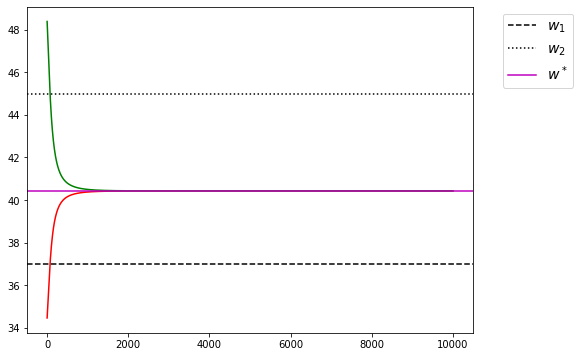

In [473]:
plt.plot([i/timestep for i in d_theta_1_list][:], "r-")
plt.plot([i/timestep for i in d_theta_2_list][:], "g-")
plt.axhline(freq_1["freq"], c="k", linestyle="dashed", label='$w_1$');
plt.axhline(freq_2["freq"], c="k",linestyle="dotted", label='$w_2$');
plt.axhline(compromise_freq, c="m", label='$w^*$');
plt.legend(bbox_to_anchor=(1.05, 1.0), loc="upper left", prop={"size":14});

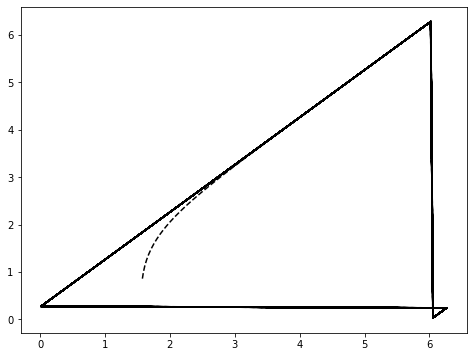

In [363]:
plt.plot(theta_1_list, theta_2_list, "k--")

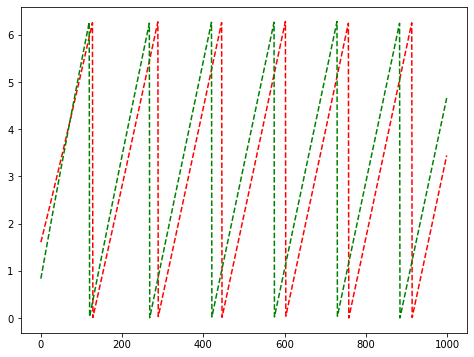

In [475]:
plt.plot(theta_1_list[:1000], "r--");
plt.plot(theta_2_list[:1000], "g--");

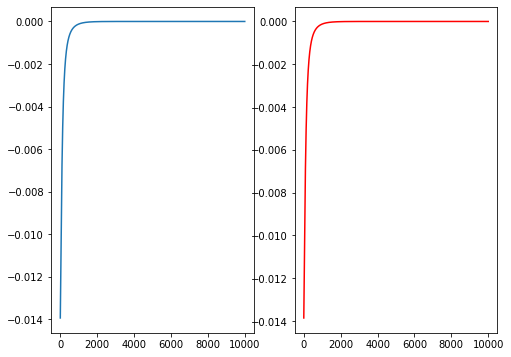

In [477]:
fig=plt.figure()
fig.add_subplot(121)
plt.plot(der_phase_diff_list)
fig.add_subplot(122)
plt.plot([(freq_1["freq"]-freq_2["freq"]-(K_1+K_2)*np.sin(phase))*timestep for phase in phase_diff_list], c="r")

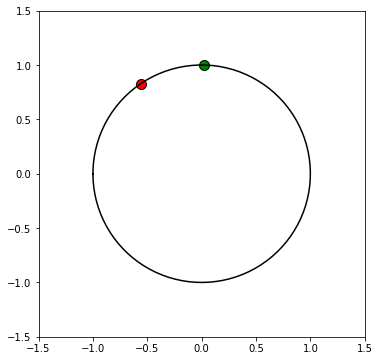

In [309]:
x,y=Unit_circle()
# create a figure with an axes
fig, ax = plt.subplots()
# set the axes limits
ax.axis([-1.5,1.5,-1.5,1.5])
# set equal aspect such that the circle is not shown as ellipse
ax.set_aspect("equal")
# create a point in the axes
cor_1, cor_2=to_polar(theta_1_list[0])
cor_3, cor_4=to_polar(theta_2_list[0])
point_1, = ax.plot(cor_1, cor_2, marker="o", markerfacecolor="r", markeredgecolor="k", markersize=10)
point_2,=ax.plot(cor_3, cor_4, marker="o", markerfacecolor="g", markeredgecolor="k", markersize=10)
line,=ax.plot(x,y, c="k")

# Updating function, to be repeatedly called by the animation
def update(i):
    cor_1, cor_2=to_polar(theta_1_list[i+1])
    cor_3, cor_4=to_polar(theta_2_list[i+1])
    point_1.set_data(cor_1, cor_2)
    point_2.set_data(cor_3, cor_4)
    return point_1, point_2,

# create animation with 10ms interval, which is repeated,
ani = FuncAnimation(fig, update, interval=100, blit=True, repeat=True,
                    frames=len(theta_1_list)-1)

In [310]:
ani

Animation size has reached 20974671 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [311]:
len(theta_1_list)

10000